In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce


from sklearn.preprocessing import StandardScaler

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor

In [5]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler

In [6]:
from sklearn.linear_model import LinearRegression

def synchronize_dataframes(dfs, df_target, target_name='Target'):
    """
    Sincroniza múltiplos DataFrames pelo timestamp e calcula o índice baseado em regressão multivariada.
    :param dfs: Lista de DataFrames contendo os preços de fechamento dos ativos.
    :param df_target: DataFrame do ativo alvo.
    :param target_name: Nome do ativo alvo (usado no resultado final).
    :return: DataFrame sincronizado com o índice de regressão e o spread.
    """
    # Mesclar todos os DataFrames pelo Timestamp
    df = df_target[['Time', 'Close', 'High', 'Low', 'Volume']].rename(columns={'Close': target_name})
    for i, df_pair in enumerate(dfs):
        df = pd.merge(df, df_pair[['Time', 'Close']].rename(columns={'Close': f'Asset_{i}'}), 
                      on='Time', how='inner')
    return df


# trienar os primeiro x elementos e gera o index com o mesmo modelo
# def apply_regression(df, target_name, training_size=100000):
#     """
#     Aplica regressão utilizando um modelo pré-treinado com os primeiros `training_size` pontos.
#     :param df: DataFrame com os dados.
#     :param target_name: Nome do ativo alvo.
#     :param training_size: Quantidade de pontos iniciais para treinar o modelo.
#     :return: DataFrame atualizado com o índice de regressão calculado.
#     """
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]

#     # Separar os dados de treinamento
#     training_data = df.iloc[:training_size]
#     X_train = training_data[asset_columns].values
#     y_train = training_data[target_name].values

#     # Normalizar os dados de treinamento
#     scaler_X = StandardScaler()
#     scaler_y = StandardScaler()
#     X_train_normalized = scaler_X.fit_transform(X_train)
#     y_train_normalized = scaler_y.fit_transform(y_train.reshape(-1, 1)).flatten()

#     # Treinar o modelo com os primeiros `training_size` pontos
#     model = LinearRegression()
#     model.fit(X_train_normalized, y_train_normalized)

#     # Gerar previsões para todo o DataFrame usando o modelo pré-treinado
#     X_all = scaler_X.transform(df[asset_columns].values)
#     y_pred_normalized = model.predict(X_all)
#     y_pred = scaler_y.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

#     # Adicionar o índice ao DataFrame
#     df['Regression_Index'] = y_pred
#     return df



def apply_regression(df, target_name, training_size=20000, prediction_size=5000):
    """
    Aplica a regressão em blocos, treinando o modelo com dados históricos e gerando índices para blocos subsequentes.
    :param df: DataFrame com os dados.
    :param target_name: Nome do ativo alvo.
    :param training_size: Tamanho do bloco de dados para treinar o modelo.
    :param prediction_size: Tamanho do bloco de dados para gerar os índices.
    :return: DataFrame atualizado com o índice de regressão calculado.
    """
    asset_columns = [col for col in df.columns if col.startswith('Asset_')]
    total_size = len(df)

    # Inicializar a coluna do índice de regressão com NaN
    regression_index = np.full(total_size, np.nan)

    # Iterar sobre os dados em blocos
    start = 0
    while start + training_size + prediction_size <= total_size:
        # Dados de treinamento
        train_end = start + training_size
        train_data = df.iloc[start:train_end]
        X_train = train_data[asset_columns].values
        y_train = train_data[target_name].values

        # Normalizar os dados de treinamento
        scaler_X = StandardScaler()
        scaler_y = StandardScaler()
        X_train_normalized = scaler_X.fit_transform(X_train)
        y_train_normalized = scaler_y.fit_transform(y_train.reshape(-1, 1)).flatten()

        # Treinar o modelo com os dados do bloco de treinamento
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Dados de previsão
        predict_start = train_end
        predict_end = predict_start + prediction_size
        X_predict = df[asset_columns].iloc[predict_start:predict_end].values

        # Normalizar os dados de previsão
        X_predict_normalized = scaler_X.transform(X_predict)

        # Prever o índice
        y_pred_normalized = model.predict(X_predict_normalized)
        y_pred = scaler_y.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

        # Atualizar os índices no array
        regression_index[predict_start:predict_end] = y_pred

        # Avançar para o próximo bloco
        start += prediction_size

    # Adicionar o índice ao DataFrame
    df['Regression_Index'] = regression_index
    return df




# def apply_regression(df, target_name):
#     # # Aplicar regressão para criar o índice base
#     # asset_columns = [col for col in df.columns if col.startswith('Asset_')]
#     # X = df[asset_columns].values  # Matriz de ativos do cluster
#     # y = df[target_name].values  # Preços do ativo alvo
#     # model = LinearRegression().fit(X, y)
#     # df['Regression_Index'] = model.predict(X)

#     """
#     Aplica regressão linear com normalização para calcular o índice base.
#     """
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]
#     X = df[asset_columns].values  # Matriz de ativos do cluster
#     y = df[target_name].values  # Preços do ativo alvo

#     # Normalizar os dados
#     scaler = StandardScaler()
#     X_normalized = scaler.fit_transform(X)
#     y_normalized = scaler.fit_transform(y.reshape(-1, 1)).flatten()

#     # Aplicar regressão
#     model = LinearRegression().fit(X_normalized, y_normalized)
#     y_pred_normalized = model.predict(X_normalized)

#     # Reverter a normalização para obter o índice em escala original
#     y_pred = scaler.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()
#     df['Regression_Index'] = y_pred
    
#     return df


#Modelo Linear POnderado
# def apply_regression(df, target_name):
#     """
#     Aplica regressão linear ponderada para calcular o índice base.
#     """
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]
#     X = df[asset_columns].values  # Matriz de ativos do cluster
#     y = df[target_name].values  # Preços do ativo alvo

#     # Normalizar os dados
#     scaler = StandardScaler()
#     X_normalized = scaler.fit_transform(X)
#     y_normalized = scaler.fit_transform(y.reshape(-1, 1)).flatten()

#     # Criar pesos exponenciais decrescentes com base na posição no tempo
#     # Os pontos mais recentes recebem maior peso
#     weights = np.exp(-np.linspace(0, 1, len(y)))

#     # Ajustar o modelo ponderado
#     model = LinearRegression()
#     model.fit(X_normalized, y_normalized, sample_weight=weights)

#     # Fazer previsões e reverter a normalização
#     y_pred_normalized = model.predict(X_normalized)
#     y_pred = scaler.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

#     df['Regression_Index'] = y_pred
#     return df






# Regressoa nao linear
# def apply_regression(df, target_name, degree=3, use_random_forest=True):
#     """
#     Aplica regressão não linear (polinomial ou Random Forest) para calcular o índice base.
#     """
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]
#     X = df[asset_columns].values  # Matriz de ativos do cluster
#     y = df[target_name].values  # Preços do ativo alvo

#     # Normalizar os dados
#     scaler_X = StandardScaler()
#     scaler_y = StandardScaler()
#     X_normalized = scaler_X.fit_transform(X)
#     y_normalized = scaler_y.fit_transform(y.reshape(-1, 1)).flatten()

#     if use_random_forest:
#         # Usar Random Forest para regressão
#         model = RandomForestRegressor(n_estimators=100, random_state=42)
#         model.fit(X_normalized, y_normalized)
#     else:
#         # Criar termos polinomiais
#         poly = PolynomialFeatures(degree=degree)
#         X_poly = poly.fit_transform(X_normalized)

#         # Ajustar o modelo polinomial
#         model = LinearRegression()
#         model.fit(X_poly, y_normalized)

#     # Fazer previsões e reverter a normalização
#     y_pred_normalized = model.predict(X_normalized if use_random_forest else X_poly)
#     y_pred = scaler_y.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

#     df['Regression_Index'] = y_pred
#     return df




# def apply_regression(df, target_name, training_size=50000, prediction_size=50000, degree=3, use_random_forest=True):
#     """
#     Aplica a regressão não linear (polinomial ou Random Forest) em blocos, 
#     treinando o modelo com dados históricos e gerando índices para blocos subsequentes.
    
#     :param df: DataFrame com os dados.
#     :param target_name: Nome do ativo alvo.
#     :param training_size: Tamanho do bloco de dados para treinar o modelo.
#     :param prediction_size: Tamanho do bloco de dados para gerar os índices.
#     :param degree: Grau do polinômio, caso use regressão polinomial.
#     :param use_random_forest: Se True, usa Random Forest; caso contrário, usa regressão polinomial.
#     :return: DataFrame atualizado com o índice de regressão calculado.
#     """
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]
#     total_size = len(df)

#     # Inicializar a coluna do índice de regressão com NaN
#     regression_index = np.full(total_size, np.nan)

#     # Iterar sobre os dados em blocos
#     start = 0
#     while start + training_size + prediction_size <= total_size:
#         # Dados de treinamento
#         train_end = start + training_size
#         train_data = df.iloc[start:train_end]
#         X_train = train_data[asset_columns].values
#         y_train = train_data[target_name].values

#         # Normalizar os dados de treinamento
#         scaler_X = StandardScaler()
#         scaler_y = StandardScaler()
#         X_train_normalized = scaler_X.fit_transform(X_train)
#         y_train_normalized = scaler_y.fit_transform(y_train.reshape(-1, 1)).flatten()

#         # Treinar o modelo
#         if use_random_forest:
#             # Random Forest para regressão
#             model = RandomForestRegressor(n_estimators=100, random_state=42)
#         else:
#             # Regressão Polinomial
#             poly = PolynomialFeatures(degree=degree)
#             X_train_normalized = poly.fit_transform(X_train_normalized)
#             model = LinearRegression()
        
#         model.fit(X_train_normalized, y_train_normalized)

#         # Dados de previsão
#         predict_start = train_end
#         predict_end = predict_start + prediction_size
#         X_predict = df[asset_columns].iloc[predict_start:predict_end].values

#         # Normalizar os dados de previsão
#         X_predict_normalized = scaler_X.transform(X_predict)
#         if not use_random_forest:
#             X_predict_normalized = poly.transform(X_predict_normalized)

#         # Prever o índice
#         y_pred_normalized = model.predict(X_predict_normalized)
#         y_pred = scaler_y.inverse_transform(y_pred_normalized.reshape(-1, 1)).flatten()

#         # Atualizar os índices no array
#         regression_index[predict_start:predict_end] = y_pred

#         # Avançar para o próximo bloco
#         start += prediction_size

#     # Adicionar o índice ao DataFrame
#     df['Regression_Index'] = regression_index
#     return df







def calculate_zscore(df, window, spread_column='Spread'):
    """
    Calcula o Z-Score do spread usando uma janela móvel.
    :param df: DataFrame com a coluna 'Spread'.
    :param spread_column: Nome da coluna de spread.
    :param window: Tamanho da janela para calcular a média e o desvio padrão.
    :return: DataFrame atualizado com a coluna 'Z-Score'.
    """
    df['Spread_Mean'] = df[spread_column].rolling(window=window).mean()
    df['Spread_Std'] = df[spread_column].rolling(window=window).std()
    df['Z-Score'] = (df[spread_column] - df['Spread_Mean']) / df['Spread_Std']
    return df


In [7]:
def run_pair(granularity,
             lenght=10000,
             strategy=1,
             target_asset='VIDTUSDT',
             cluster_asset=['AVAXUSDT','BNBUSDT','LTCUSDT'],
             entry_threshold=3,
             exit_threshold=0,
             window=50
            ):

    # Carregar os DataFrames de ativos
    df_target = pd.read_pickle(f"crypto/{target_asset}_{granularity}.pkl")
    dfs_cluster = [
        pd.read_pickle(f"crypto/{asset}_{granularity}.pkl") for asset in cluster_asset
    ]
    
    
    # Sincronizar e calcular o índice PCA e o spread
    df = synchronize_dataframes(dfs_cluster, df_target, target_name=target_asset)
    
    df = apply_regression(df, target_asset)
    # Remover valores iniciais onde o índice não foi calculado
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)
    
    # Calcular o spread com o ativo alvo
    df['Spread'] = df[target_asset] - df['Regression_Index']


    # Calcular o Z-Score do spread
    df = calculate_zscore(df, window, spread_column='Spread')

    df['Close_Pair1'] = df[target_asset]
    
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)

    df['Volume_Mean'] = df['Volume'].rolling(window=20).mean()  # Média de 20 períodos
    df['Volume_75th'] = df['Volume'].rolling(window=100).quantile(0.75)  # 75º percentil

    # Filtro 1: Volume maior que a média dos últimos 20 períodos
    df['Volume_Valid'] = df['Volume'] > df['Volume_Mean']
    
    # Filtro 2: Volume maior que o 75º percentil dos últimos 100 períodos
    df['Volume_Valid'] &= df['Volume'] > df['Volume_75th']
    
    # Filtro 3: Mudança percentual significativa no volume
    df['Volume_Change'] = df['Volume'].pct_change()
    df['Volume_Valid'] &= df['Volume_Change'] > 0.5  # Mudança > 50%
    

    corr = 0
    spread_vol = 0


    df['time'] = df['Time'].copy()
    df['strategy_pair1'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['creturns_pair1'] = df['returns_pair1'].cumsum()
    df['Log_Returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['cLog_Returns_pair1'] = df['Log_Returns_pair1'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        entry_threshold,
        exit_threshold,
        corr,
        spread_vol
    )
    
    gt.run_test()
    return gt
    

In [8]:
import pandas as pd

# Carregar os clusters do arquivo
def load_clusters():
    clusters_df = pd.read_csv('best_clusters_overall.csv')
    clusters = {}
    for target_asset in clusters_df['target_asset'].unique():
        clusters[target_asset] = clusters_df[clusters_df['target_asset'] == target_asset]['asset'].tolist()
    return clusters

# Obter os clusters para cada ativo alvo
clusters = load_clusters()


In [9]:
# Verificar os clusters utilizados
for target_asset, cluster_asset in clusters.items():
    print(f"Ativo Alvo: {target_asset}")
    print(f"Cluster: {cluster_asset[:10]}")


Ativo Alvo: DOTUSDT
Cluster: ['MASKUSDT', 'EOSUSDT', 'SANDUSDT']
Ativo Alvo: DOGEUSDT
Cluster: ['CHRUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: ADAUSDT
Cluster: ['DASHUSDT', 'PERPUSDT', 'ACHUSDT', 'CHRUSDT', 'TRXUSDT', 'CELOUSDT', 'APTUSDT', 'EOSUSDT', 'XRPUSDT']
Ativo Alvo: XRPUSDT
Cluster: ['PERPUSDT', 'DASHUSDT', 'APTUSDT', 'TRXUSDT', 'ACHUSDT', 'ALGOUSDT', 'ADAUSDT', 'BCHUSDT', 'BANDUSDT', 'EOSUSDT']
Ativo Alvo: TRXUSDT
Cluster: ['CHRUSDT', 'XRPUSDT', 'CELOUSDT', 'EOSUSDT', 'ADAUSDT']
Ativo Alvo: XLMUSDT
Cluster: ['XRPUSDT', 'CHRUSDT', 'ADAUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: APTUSDT
Cluster: ['SANDUSDT', 'EOSUSDT', 'LTCUSDT']
Ativo Alvo: VIDTUSDT
Cluster: ['XRPUSDT', 'CHRUSDT', 'ADAUSDT', 'CELOUSDT', 'EOSUSDT']
Ativo Alvo: AVAXUSDT
Cluster: ['SANDUSDT']
Ativo Alvo: LINKUSDT
Cluster: ['APTUSDT']
Ativo Alvo: EOSUSDT
Cluster: ['ALGOUSDT', 'ACHUSDT', 'CELOUSDT', 'CHRUSDT', 'XRPUSDT']
Ativo Alvo: ETCUSDT
Cluster: ['APTUSDT', 'MASKUSDT', 'DOTUSDT', 'ALPHAUSDT', 'DOGEUSDT', 'ALGOUSDT'

In [10]:
# df.columns

In [11]:
def get_list_args():
    args_dic_list = []
    for target_asset, cluster_asset in clusters.items():
        for granularity in ['1m']:
            for lenght in ['2024-01-01 00:00:00']:
                for strategy in [1]:
                    for entry_threshold in [2]:
                        for exit_threshold in [1]:
                            if entry_threshold > exit_threshold:
                                for window in [100]:
                                    args_dic = {
                                        "granularity": granularity,
                                        "lenght": lenght,
                                        "strategy": strategy,
                                        "target_asset": target_asset,
                                        "cluster_asset": cluster_asset,  # Limitar a 10 ativos
                                        "entry_threshold": entry_threshold,
                                        "exit_threshold": exit_threshold,
                                        "window": window
                                    }
                                    args_dic_list.append(args_dic)
    return args_dic_list


In [12]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            target_asset=arg['target_asset'],
            cluster_asset=arg['cluster_asset'],
            granularity=arg['granularity'],
            lenght = arg['lenght'],
            strategy = arg['strategy'],
            entry_threshold = arg['entry_threshold'],
            exit_threshold = arg['exit_threshold'],
            window = arg['window'],
            res=run_pair(
                granularity=arg['granularity'],
                lenght = arg['lenght'],
                strategy= arg['strategy'],
                target_asset=arg['target_asset'],
                cluster_asset=arg['cluster_asset'],
                entry_threshold = arg['entry_threshold'],
                exit_threshold = arg['exit_threshold'],
                window = arg['window']
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # Lista compartilhada entre processos
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L, args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)

        

In [13]:
%%time

run_ema_macd()

23
0
10
20
ALL DONE
CPU times: user 48.3 ms, sys: 369 ms, total: 418 ms
Wall time: 51 s


In [14]:


# ddf = lista[0]['res'].df.copy()

In [40]:
# with open(f"./result-pair-trading-new-data-strategy-1-CPA-with-sl-0.05-1min-2023-to-end.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo



In [41]:
# listaa = []

# # Carregar os arquivos e expandir seus conteúdos diretamente na lista principal
# for filename in [
#     "./result-binance-acumulative-percentual-strategy-1-2-3-4-5.pkl",
#     "./result-binance-acumulative-percentual-strategy-6-7-8-9.pkl",
#     "./result-binance-acumulative-percentual-strategy-10-11-12.pkl"
# ]:
#     with open(filename, "rb") as f:
#         listaa.extend(pickle.load(f))
        
# with open(f"./result-binance-acumulative-percentual-strategy-1-12.pkl", "wb") as f:
#     pickle.dump(listaa, f)  # Usa o pickle para salvar o arquivo



In [42]:
# cp = CandlePlot(ddf.iloc[-50000:],candles=False)


# trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP_PAIR1 == 1]

# trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN_PAIR1 == 1]

# print(len(trades_up),len(trades_down))

In [43]:

# marker_trade_up = '#abebc6'
# marker_trade_down = '#cccddd'


# markers = 'Close_Pair1'


# cp.add_traces(['Close_Pair1'])


# # # SIGNAL UP
# cp.fig.add_trace(go.Scatter(
#     x = trades_up.sTime,
#     y = trades_up[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-up',
#     marker=dict(color=marker_trade_up, size=12)
# ))

# cp.fig.add_trace(go.Scatter(
#     x = trades_down.sTime,
#     y = trades_down[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-down',
#     marker=dict(color=marker_trade_down, size=12)
# ))


# cp.show_plot(height=700, width=1100, sec_traces=['PCA_Index'])

In [44]:
res = lista

# with open(f"./result-binance-acumulative-percentual-new-data-strategy-14-1min-2024-split_profit.pkl", "rb") as f:
#     res = pickle.load(f)

In [45]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] <= 0]
        sum_neg_s = res_neg_s.strategy_pair1.sum() *-1
        sum_pos_s = res_pos_s.strategy_pair1.sum()
        dic_res.append(
            dict(
                pair1 = r['target_asset'],
                granularity = r['granularity'],
                strat = round(r['res'].df_results.strategy_pair1.sum(),3),
                c = r['res'].df_results['count'].mean(),
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                entry_threshold = r['entry_threshold'],
                exit_threshold = r['exit_threshold'],
                window = r['window'],
                
                corr = r['res'].corr,
                spread_vol = r['res'].spread_vol,
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),
        
                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),

                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                # df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [46]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [47]:
df_res = pd.DataFrame(dic_res)

In [48]:
df_sorted_desc = df_res.sort_values(by=['pair1','strat'], ascending=False)

In [49]:
df_sorted_desc.columns

Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'exit_threshold', 'window', 'corr', 'spread_vol', 's_p_strat',
       's_n_strat', 'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c',
       'l_o', 'first_p', 'last_p', 'first_t', 'last_t', 'r'],
      dtype='object')

In [50]:
# Exibir todas as linhas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df_sorted_desc.head(150)[['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,granularity,strat,c,max_o,st,entry_threshold,window,corr,spread_vol,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
9,XRPUSDT,1m,-3.996,19.517193,1,1,2,100,0,0,7.436827,11.432631,0.394120,3072,4111,0.427676,7183,0
7,XLMUSDT,1m,2.857,13.431049,1,1,2,100,0,0,10.287397,7.430482,0.580622,6653,2861,0.699285,9514,0
5,VIDTUSDT,1m,7.623,15.810834,1,1,2,100,0,0,23.334917,15.712055,0.597611,5542,2710,0.671595,8252,0
6,TRXUSDT,1m,-4.146,19.729126,1,1,2,100,0,0,2.198766,6.344904,0.257356,1988,5222,0.275728,7210,0
16,SANDUSDT,1m,-3.206,17.687638,1,1,2,100,0,0,10.831145,14.036806,0.435546,3640,4069,0.472175,7709,0
11,PERPUSDT,1m,-1.322,18.949317,1,1,2,100,0,0,16.520552,17.842776,0.480761,4224,3175,0.570888,7399,1
0,LINKUSDT,1m,-3.577,18.821533,1,1,2,100,0,0,9.733925,13.310878,0.422391,4172,3342,0.555230,7514,0
19,ETCUSDT,1m,-3.879,17.278819,1,1,2,100,0,0,9.589937,13.469208,0.415884,3636,4258,0.460603,7894,0
14,EOSUSDT,1m,-1.758,17.655379,1,1,2,100,0,0,10.153223,11.910993,0.460167,4093,3585,0.533082,7678,0
3,DOTUSDT,1m,-4.136,18.888995,1,1,2,100,0,0,9.073349,13.208989,0.407199,3349,3948,0.458956,7297,0


In [51]:
# df_sorted_desc.iloc[4].r['time'] = df_sorted_desc.iloc[4].r['end_time']
# df_sorted_desc.iloc[4].r['GAIN_C'] = df_sorted_desc.iloc[4].r.strategy.cumsum()

# cp = CandlePlot(df_sorted_desc.iloc[4].r, candles=False)
# cp.show_plot(line_traces = ['GAIN_C'])

In [52]:
def rank_backtest_results(df):
    # Definindo pesos para cada coluna com base na importância
    weights = {
        'strat': 0.4,           # Retorno acumulado percentual (maximizar)
        'Rel_sum': 0.2,        # Relação de resultados positivos/negativos (maximizar)
    }
    
    # Normalizando as colunas relevantes
    for col in weights.keys():
        df[col + '_norm'] = (df[col] - df[col].min()) / (df[col].max() - df[col].min())
    
    # Calculando o score ponderado para cada linha
    df['score'] = sum(
        df[col + '_norm'] * weight if weight >= 0 else (1 - df[col + '_norm']) * abs(weight) 
        for col, weight in weights.items()
    )
    
    # Ordenando o DataFrame pelos melhores resultados com base no score
    df_sorted = df.sort_values(by='score', ascending=False).reset_index(drop=True)
    
    # Removendo colunas de normalização temporárias
    df_sorted.drop(columns=[col + '_norm' for col in weights.keys()], inplace=True)
    
    return df_sorted

In [53]:
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

In [54]:
# df_APTUSDT = df_res[df_res['pair']=='APTUSDT']
# df_DOTUSDT = df_res[df_res['pair']=='DOTUSDT']
# df_DOGEUSDT = df_res[df_res['pair']=='DOGEUSDT']
# df_ADAUSDT = df_res[df_res['pair']=='ADAUSDT']
# df_XRPUSDT = df_res[df_res['pair']=='XRPUSDT']
# df_VIDTUSDT = df_res[df_res['pair']=='VIDTUSDT']
# df_TRXUSDT = df_res[df_res['pair']=='TRXUSDT']
# df_XLMUSDT = df_res[df_res['pair']=='XLMUSDT']

In [55]:
# rank_APT = rank_backtest_results(df_APTUSDT)
# rank_DOT = rank_backtest_results(df_DOTUSDT)
# rank_DOGE = rank_backtest_results(df_DOGEUSDT)
# rank_ADA = rank_backtest_results(df_ADAUSDT)
# rank_XRP = rank_backtest_results(df_XRPUSDT)
# rank_VIDT = rank_backtest_results(df_VIDTUSDT)
# rank_TRX = rank_backtest_results(df_TRXUSDT)
# rank_XLM = rank_backtest_results(df_XLMUSDT)



In [56]:
# Lista de pares
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
         'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

# Dicionários para armazenar DataFrames e ranks
df_dict = {}
rank_dict = {}

# Loop para criar DataFrames e calcular ranks
for pair in pairs:
    df_dict[pair] = df_res[df_res['pair1'] == pair]
    rank_dict[pair] = rank_backtest_results(df_dict[pair])



In [57]:
# Exemplo de como acessar os resultados
df_dict['DOTUSDT'].columns  # DataFrame do par DOTUSDT


Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'exit_threshold', 'window', 'corr', 'spread_vol', 's_p_strat',
       's_n_strat', 'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c',
       'l_o', 'first_p', 'last_p', 'first_t', 'last_t', 'r', 'strat_norm',
       'Rel_sum_norm', 'score'],
      dtype='object')

In [58]:
mean_dict = []
for pair in pairs:
    dic_ = {
        "pair": pair,
        "strat": round(rank_dict[pair].strat.mean(),2),
        "rel_sum": round(rank_dict[pair].Rel_sum.mean(),2)
    }
    mean_dict.append(dic_)
    
df_mean = pd.DataFrame(mean_dict)

df_mean = df_mean.sort_values(by='strat', ascending=False).reset_index(drop=True)
df_mean

,pair,strat,rel_sum
0,VIDTUSDT,7.62,0.60
1,ALPHAUSDT,5.28,0.58
2,XLMUSDT,2.86,0.58
3,DASHUSDT,1.72,0.54
4,BANDUSDT,0.22,0.50
5,APTUSDT,-0.38,0.49
6,ALGOUSDT,-0.72,0.49
7,CHRUSDT,-1.31,0.48
8,PERPUSDT,-1.32,0.48
9,ACHUSDT,-1.74,0.47


In [59]:
rank_dict['VIDTUSDT'] = rank_dict['VIDTUSDT'].round(2)
rank_dict['VIDTUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,VIDTUSDT,7.62,15.81,1,2,1,100,23.33,15.71,0.6,5542,2710,0.67,8252,0


In [60]:
rank_dict['XLMUSDT'] = rank_dict['XLMUSDT'].round(2)
rank_dict['XLMUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,XLMUSDT,2.86,13.43,1,2,1,100,10.29,7.43,0.58,6653,2861,0.7,9514,0


In [61]:
rank_dict['ALPHAUSDT'] = rank_dict['ALPHAUSDT'].round(2)
rank_dict['ALPHAUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,ALPHAUSDT,5.28,13.72,1,2,1,100,19.56,14.28,0.58,6296,3308,0.66,9604,1


In [62]:
rank_dict['DASHUSDT'] = rank_dict['DASHUSDT'].round(2)
rank_dict['DASHUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','exit_threshold','window', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,exit_threshold,window,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,DASHUSDT,1.72,16.88,1,2,1,100,11.34,9.62,0.54,4834,2954,0.62,7788,0


In [63]:
def get_daily_operations_with_strategy(df):
    """
    Retorna um novo DataFrame com a quantidade de operações por dia e o total da soma da coluna 'strategy_pair1'.
    
    :param df: DataFrame original com as colunas 'start_time' e 'strategy_pair1'.
    :return: DataFrame com a contagem de operações por dia e o total de 'strategy_pair1' por dia.
    """
    # Criar uma cópia do DataFrame original para não alterá-lo
    df_copy = df.copy()
    
    # Converter a coluna 'start_time' para o formato datetime, se necessário
    df_copy['start_time'] = pd.to_datetime(df_copy['start_time'])
    
    # Criar uma nova coluna com apenas a data
    df_copy['time'] = df_copy['start_time'].dt.date
    
    # Agrupar por data e calcular a quantidade de operações e soma de 'strategy_pair1'
    daily_operations = df_copy.groupby('time').agg(
        operation_count=('start_time', 'size'),
        total_strategy=('strategy_pair1', 'sum')
    ).reset_index()
    
    return daily_operations


# VIDT USDT

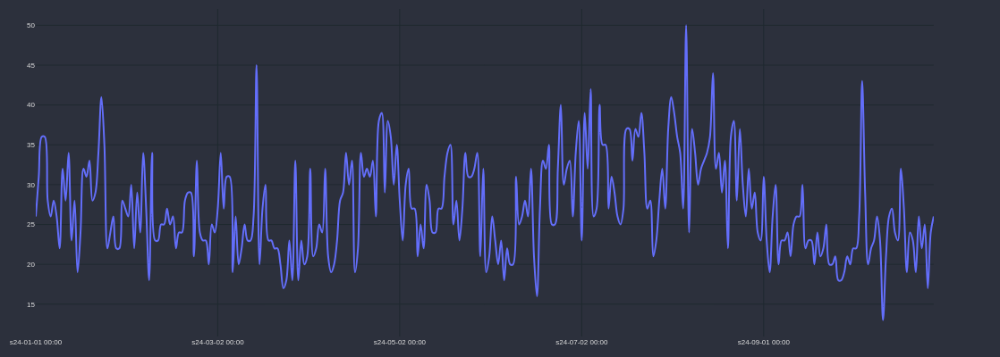

In [64]:
df_op = get_daily_operations_with_strategy(rank_dict['VIDTUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['operation_count'])

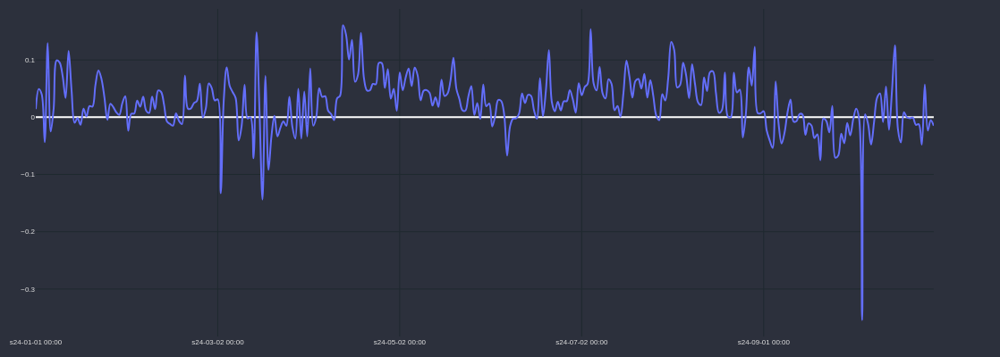

In [65]:
df_op = get_daily_operations_with_strategy(rank_dict['VIDTUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy'])

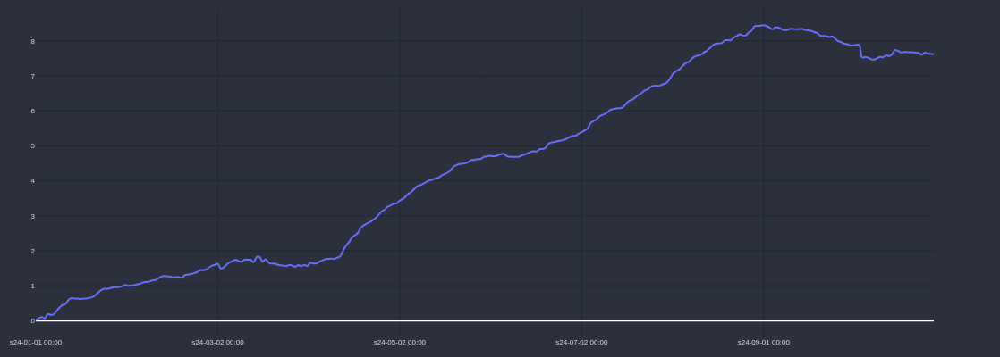

In [66]:
df_op = get_daily_operations_with_strategy(rank_dict['VIDTUSDT'].iloc[0].r)
df_op['total_strategy_sum'] = df_op.total_strategy.cumsum()
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy_sum'])

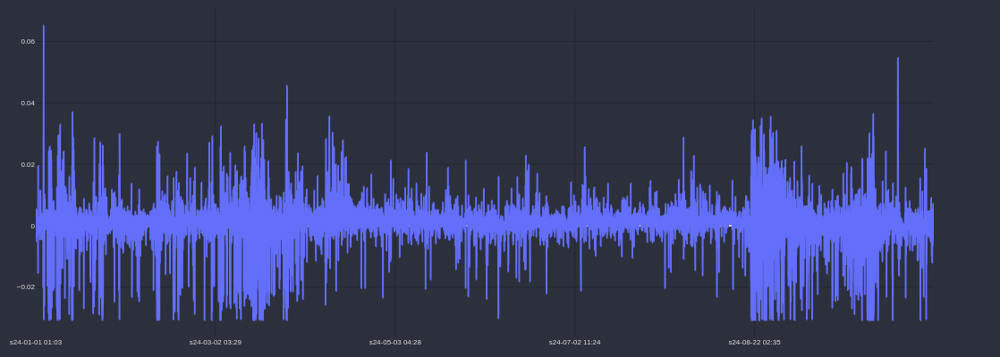

In [67]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

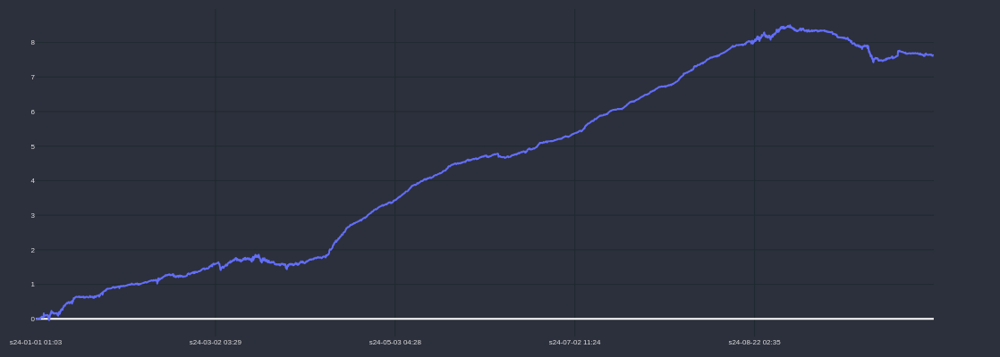

In [68]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1.cumsum()

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

# Alpha USDT

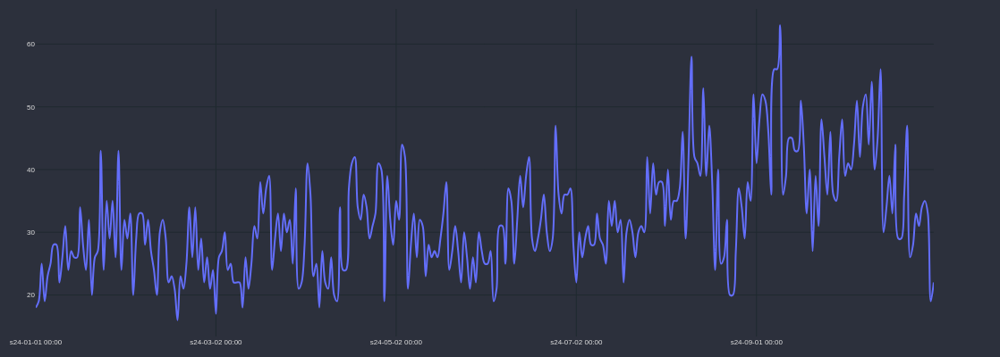

In [78]:
df_op = get_daily_operations_with_strategy(rank_dict['ALPHAUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['operation_count'])

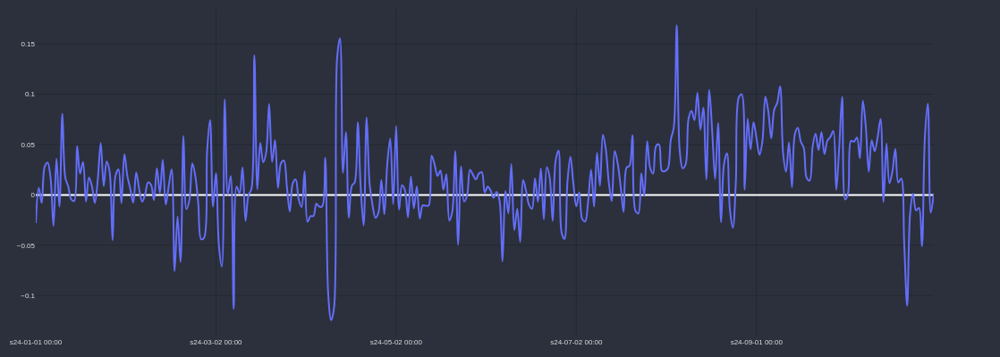

In [79]:
df_op = get_daily_operations_with_strategy(rank_dict['ALPHAUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy'])

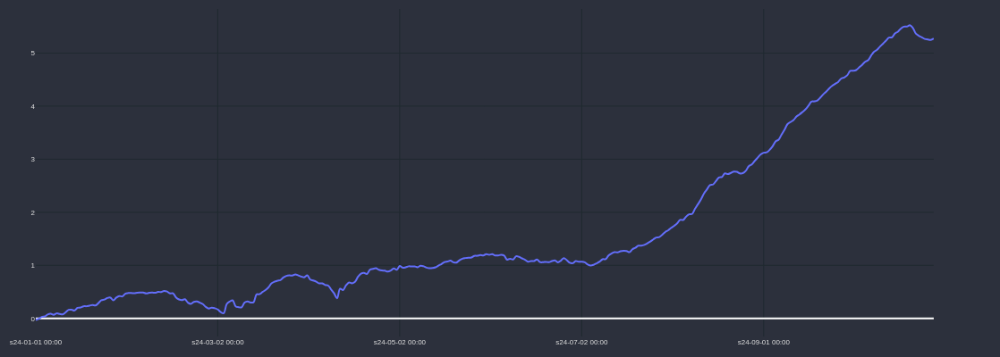

In [69]:
df_op = get_daily_operations_with_strategy(rank_dict['ALPHAUSDT'].iloc[0].r)
df_op['total_strategy_sum'] = df_op.total_strategy.cumsum()
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy_sum'])

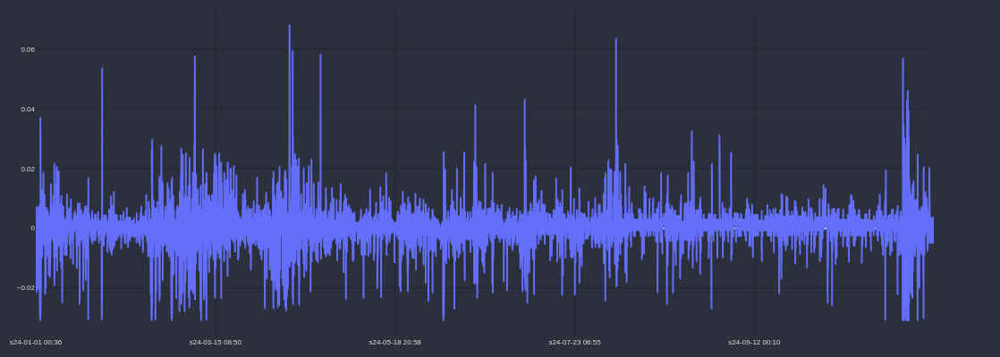

In [80]:
for index in range(len(rank_dict['ALPHAUSDT'])):
    rank = rank_dict['ALPHAUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

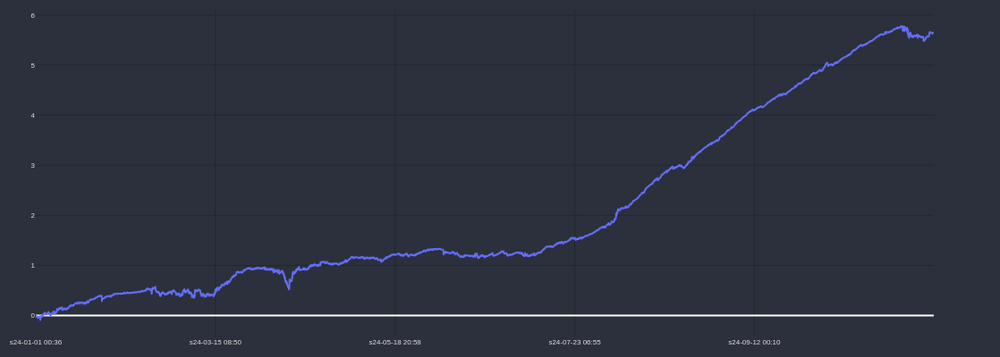

In [81]:
for index in range(len(rank_dict['ALPHAUSDT'])):
    rank = rank_dict['ALPHAUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1.cumsum()

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

# XML USDT

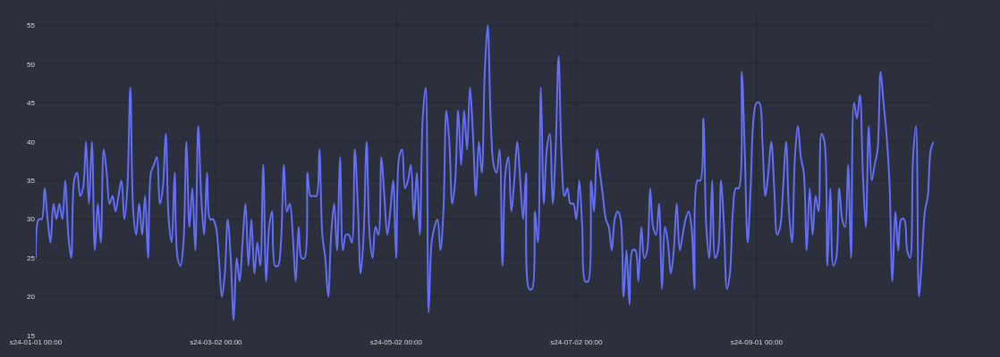

In [82]:
df_op = get_daily_operations_with_strategy(rank_dict['XLMUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['operation_count'])

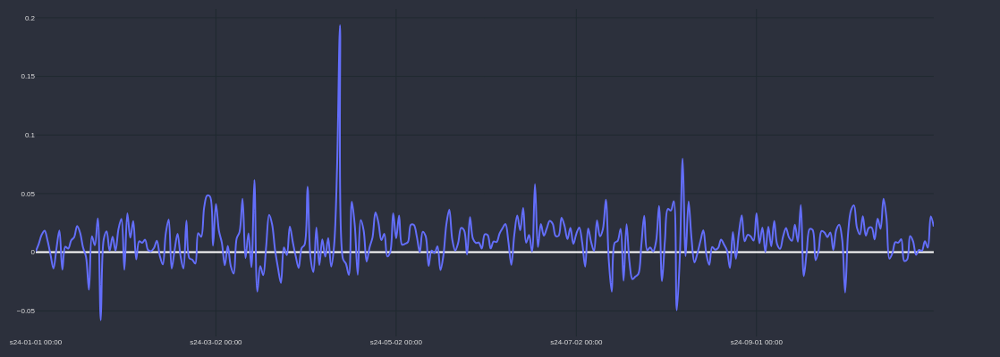

In [83]:
df_op = get_daily_operations_with_strategy(rank_dict['XLMUSDT'].iloc[0].r)
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy'])

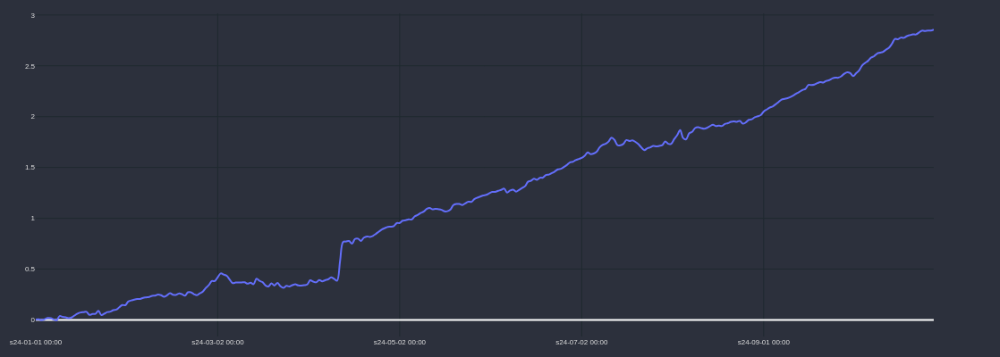

In [70]:
df_op = get_daily_operations_with_strategy(rank_dict['XLMUSDT'].iloc[0].r)
df_op['total_strategy_sum'] = df_op.total_strategy.cumsum()
cp = CandlePlot(df_op, candles=False)
cp.show_plot(line_traces = ['total_strategy_sum'])

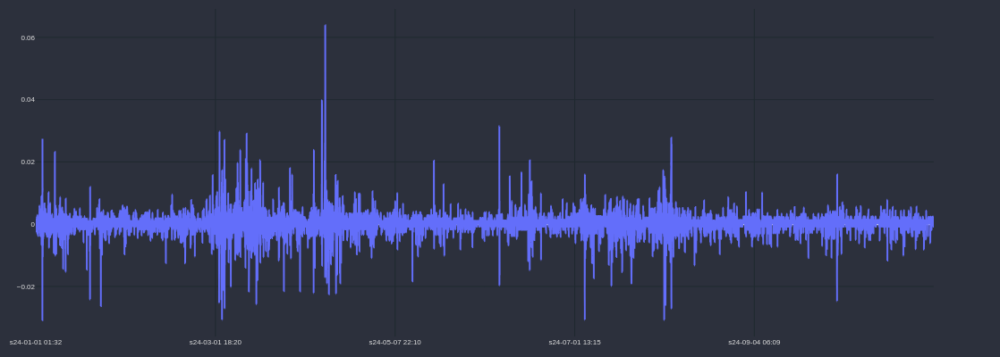

In [84]:
for index in range(len(rank_dict['XLMUSDT'])):
    rank = rank_dict['XLMUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

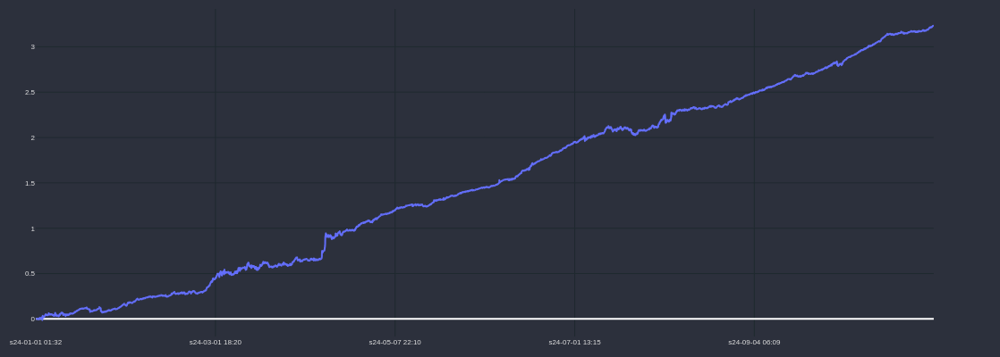

In [85]:
for index in range(len(rank_dict['XLMUSDT'])):
    rank = rank_dict['XLMUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1.cumsum()

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

In [86]:
def calcular_operacoes_simultaneas(df):
    # Ordena o DataFrame por start_time para facilitar o cálculo
    df = df.sort_values(by='start_time').reset_index(drop=True)
    # Inicializa a coluna operacoes_simultaneas com o valor mínimo de 0
    df['operacoes_simultaneas'] = 0
    
    # Itera sobre cada operação e conta quantas estão abertas e não fechadas no momento
    for i, row in df.iterrows():
        # Conta quantas operações estão em andamento no tempo de start_time da operação atual
        count = ((df['start_time'] <= row['start_time']) & (df['end_time'] > row['start_time'])).sum()
        # Atualiza a coluna com o número de operações simultâneas, garantindo o mínimo de 1
        df.at[i, 'operacoes_simultaneas'] = max(count, 1)
        
    return df

In [87]:

# # Concatenar os DataFrames filtrados, acessando os 10 primeiros elementos do atributo `r` de cada um
# concat_ranks = pd.concat(
#     [
#         rank_dict['VIDTUSDT'].iloc[index].r for index in range(1)
#     ]
# )


# Concatenar os DataFrames filtrados, acessando os 10 primeiros elementos do atributo `r` de cada um
concat_ranks = pd.concat(
    [
        rank_dict['VIDTUSDT'].iloc[0].r,
        rank_dict['XLMUSDT'].iloc[0].r,
        rank_dict['ALPHAUSDT'].iloc[0].r,
        # rank_dict['DASHUSDT'].iloc[0].r 
    ]
)


In [88]:
concat_ranks.shape

(27993, 22)

In [89]:
concat_ranks.strategy_pair1.sum()

np.float64(16.41809760962476)

In [90]:
df_test = calcular_operacoes_simultaneas(concat_ranks)
df_test.operacoes_simultaneas.max()

np.int64(3)

In [91]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
27988,False,431189,42,0,-0.000037,0.000763,1,False,0,0.02,-0.02,-0.03,buy,0.02619,0.02621,1,0,0.00002,2024-10-31 23:07:00,2024-10-31 22:26:00,2024-10-31 23:07:00,7.540902,1
27989,False,432000,51,0,-0.005196,-0.004396,1,False,0,0.02,-0.02,-0.03,sell,0.06810,0.06840,0,1,-0.00030,2024-10-31 23:27:00,2024-10-31 22:37:00,2024-10-31 23:27:00,5.640433,2
27990,False,437414,14,0,0.000280,0.001080,1,False,0,0.02,-0.02,-0.03,sell,0.09260,0.09250,0,1,0.00010,2024-10-31 22:55:00,2024-10-31 22:41:00,2024-10-31 22:55:00,3.236140,3
27991,False,437448,10,0,0.000279,0.001079,1,False,0,0.02,-0.02,-0.03,sell,0.09270,0.09260,0,1,0.00010,2024-10-31 23:27:00,2024-10-31 23:18:00,2024-10-31 23:27:00,3.236419,2
27992,False,431242,13,0,0.000343,0.001143,1,False,0,0.02,-0.02,-0.03,buy,0.02623,0.02626,1,0,0.00003,2024-10-31 23:32:00,2024-10-31 23:19:00,2024-10-31 23:32:00,7.541245,3


In [92]:
concat_ranks.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'stop_loss', 'type',
       'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result',
       'end_time', 'start_time', 'time', 'GAIN_I'],
      dtype='object')

In [93]:
df_test.strategy_pair1.sum()

np.float64(16.41809760962476)

In [94]:
(5000/df_test.operacoes_simultaneas.max()) * df_test.strategy_pair1.sum()

np.float64(27363.496016041267)

In [95]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
27988,False,431189,42,0,-0.000037,0.000763,1,False,0,0.02,-0.02,-0.03,buy,0.02619,0.02621,1,0,0.00002,2024-10-31 23:07:00,2024-10-31 22:26:00,2024-10-31 23:07:00,7.540902,1
27989,False,432000,51,0,-0.005196,-0.004396,1,False,0,0.02,-0.02,-0.03,sell,0.06810,0.06840,0,1,-0.00030,2024-10-31 23:27:00,2024-10-31 22:37:00,2024-10-31 23:27:00,5.640433,2
27990,False,437414,14,0,0.000280,0.001080,1,False,0,0.02,-0.02,-0.03,sell,0.09260,0.09250,0,1,0.00010,2024-10-31 22:55:00,2024-10-31 22:41:00,2024-10-31 22:55:00,3.236140,3
27991,False,437448,10,0,0.000279,0.001079,1,False,0,0.02,-0.02,-0.03,sell,0.09270,0.09260,0,1,0.00010,2024-10-31 23:27:00,2024-10-31 23:18:00,2024-10-31 23:27:00,3.236419,2
27992,False,431242,13,0,0.000343,0.001143,1,False,0,0.02,-0.02,-0.03,buy,0.02623,0.02626,1,0,0.00003,2024-10-31 23:32:00,2024-10-31 23:19:00,2024-10-31 23:32:00,7.541245,3


In [96]:
df_test.describe()

,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
count,27993.000000,27993.000000,27993.0,27993.000000,27993.000000,27993.0,27993.0,27993.00,27993.00,2.799300e+04,27993.000000,27993.000000,27993.000000,27993.000000,27993.000000,27993,27993,27993,27993.000000,27993.000000
mean,223537.470046,14.029043,0.0,0.000587,0.001333,1.0,0.0,0.02,-0.02,-3.000000e-02,0.079808,0.079801,0.482478,0.517522,0.000094,2024-06-06 09:59:19.622763008,2024-06-06 09:46:09.636694784,2024-06-06 09:59:19.622763008,2.574903,1.596185
min,24.000000,2.000000,0.0,-0.030800,-0.117400,1.0,0.0,0.02,-0.02,-3.000000e-02,0.013960,0.014190,0.000000,0.000000,-0.013800,2024-01-01 00:36:00,2024-01-01 00:24:00,2024-01-01 00:36:00,-0.091255,1.000000
25%,117253.000000,4.000000,0.0,-0.000800,0.000000,1.0,0.0,0.02,-0.02,-3.000000e-02,0.044070,0.044100,0.000000,0.000000,0.000000,2024-03-23 20:53:00,2024-03-23 20:49:00,2024-03-23 20:53:00,0.934380,1.000000
50%,228753.000000,9.000000,0.0,0.000858,0.001658,1.0,0.0,0.02,-0.02,-3.000000e-02,0.090100,0.090200,0.000000,1.000000,0.000100,2024-06-09 22:48:00,2024-06-09 22:44:00,2024-06-09 22:48:00,1.642347,1.000000
75%,331559.000000,19.000000,0.0,0.002466,0.003266,1.0,0.0,0.02,-0.02,-3.000000e-02,0.108900,0.108900,1.000000,1.000000,0.000200,2024-08-21 09:27:00,2024-08-21 09:17:00,2024-08-21 09:27:00,3.867831,2.000000
max,437448.000000,155.000000,0.0,0.068007,0.068807,1.0,0.0,0.02,-0.02,-3.000000e-02,0.206800,0.204000,1.000000,1.000000,0.010200,2024-10-31 23:32:00,2024-10-31 23:19:00,2024-10-31 23:32:00,8.444299,3.000000
std,124823.606900,14.348360,0.0,0.005899,0.006302,0.0,0.0,0.00,0.00,1.040853e-17,0.039205,0.039201,0.499702,0.499702,0.000530,NaN,NaN,NaN,2.277719,0.661405


In [97]:
df_test = df_test.sort_values(by='end_time', ascending=True).reset_index(drop=True)
df_test.head()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_I,operacoes_simultaneas
0,False,27,10,0,0.003195,0.003995,1,False,0,0.02,-0.02,-0.03,buy,0.12490,0.12540,1,0,0.00050,2024-01-01 00:36:00,2024-01-01 00:27:00,2024-01-01 00:36:00,0.003195,2
1,False,24,18,0,-0.001157,-0.000357,1,False,0,0.02,-0.02,-0.03,buy,0.02800,0.02799,1,0,-0.00001,2024-01-01 00:42:00,2024-01-01 00:24:00,2024-01-01 00:42:00,-0.001157,1
2,False,51,9,0,0.000270,0.001070,1,False,0,0.02,-0.02,-0.03,buy,0.02802,0.02805,1,0,0.00003,2024-01-01 01:03:00,2024-01-01 00:54:00,2024-01-01 01:03:00,-0.000887,1
3,False,84,9,0,-0.000029,0.000771,1,False,0,0.02,-0.02,-0.03,sell,0.12980,0.12970,0,1,0.00010,2024-01-01 01:32:00,2024-01-01 01:24:00,2024-01-01 01:32:00,-0.000029,1
4,False,124,4,0,0.000743,0.001543,1,False,0,0.02,-0.02,-0.03,sell,0.12970,0.12950,0,1,0.00020,2024-01-01 02:07:00,2024-01-01 02:04:00,2024-01-01 02:07:00,0.000714,2


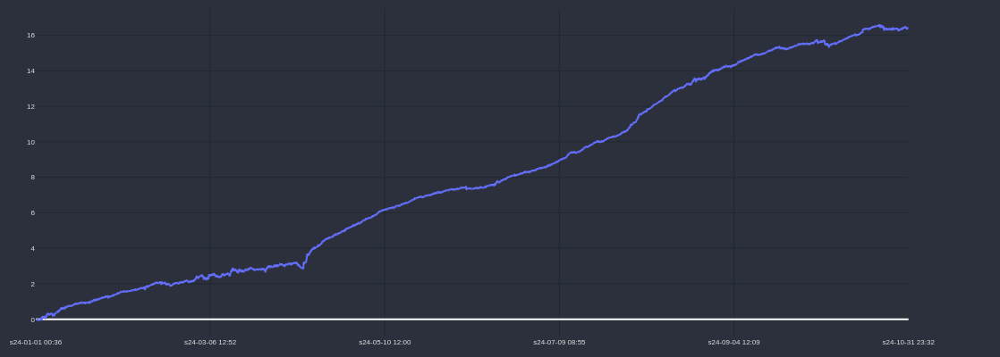

In [99]:

df_test['time'] = df_test['end_time']
df_test['GAIN_C'] = df_test.strategy_pair1.cumsum()

cp = CandlePlot(df_test, candles=False)
cp.show_plot(line_traces = ['GAIN_C'])#, sec_traces=['operacoes_simultaneas'])

In [100]:
pos = df_test[df_test['strategy_pair1']>0]
neg = df_test[df_test['strategy_pair1']<0]

print(len(pos),len(neg), len(pos)/(len(pos)+len(neg)))

18928 9065 0.6761690422605652


In [101]:
df_test.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'stop_loss', 'type',
       'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result',
       'end_time', 'start_time', 'time', 'GAIN_I', 'operacoes_simultaneas',
       'GAIN_C'],
      dtype='object')

In [102]:
import numpy as np
import pandas as pd

def calcular_retorno_dinamico_com_alavancagem(df, saldo_total, alavancagem=1, percentual_capital=10):
    """
    Calcula o retorno acumulado em dólar com controle de reserva, considerando operações simultâneas e mantendo
    o saldo total inalterado até que as operações sejam fechadas. Adiciona incremento de 2% ao capital usado.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo as colunas `start_time`, `end_time`, e `strategy`.
        saldo_total (float): Saldo total inicial disponível para operações.
        alavancagem (float): Fator de alavancagem a ser aplicado nas operações.
        percentual_capital (float): Percentual do saldo total a ser usado em cada operação.

    Retorno:
        pd.DataFrame: DataFrame atualizado com colunas adicionais e métricas.
    """
    # Ordenar o DataFrame pelo tempo de abertura
    df = df.sort_values(by="start_time").reset_index(drop=True)

    # Inicializar arrays e variáveis
    n = len(df)
    capital_usado = saldo_total / percentual_capital
    incremento_percentual = 0.0

    status = np.full(n, "fechada", dtype=object)
    retorno_dolar = np.zeros(n)
    capital_acumulado = np.full(n, saldo_total)
    saldo_total_arr = np.full(n, saldo_total)
    capital_usado_arr = np.zeros(n)

    for i in range(n):
        # Fechar operações cujo end_time já passou
        abertas = (status == "aberta") & (df["end_time"].values <= df["start_time"].iloc[i])
        for j in np.where(abertas)[0]:
            retorno_alavancado = alavancagem * (df["strategy_pair1"].iloc[j] * capital_usado_arr[j])
            saldo_total += retorno_alavancado  # Atualizar saldo total com o retorno da operação
            retorno_dolar[j] = retorno_alavancado
            status[j] = "fechada"
            # Recalcular o capital usado após fechar uma operação
            capital_usado = saldo_total / percentual_capital

        # Incrementar o capital usado em 2% para a nova operação
        capital_usado *= (1 + incremento_percentual)
        capital_usado_arr[i] = capital_usado

        # Marcar a operação como aberta
        status[i] = "aberta"

        # Atualizar o saldo acumulado e saldo total
        saldo_total_arr[i] = saldo_total
        capital_acumulado[i] = saldo_total

    # Adicionar os resultados ao DataFrame
    df["capital_usado"] = capital_usado_arr
    df["retorno_dolar"] = retorno_dolar
    df["capital_acumulado"] = capital_acumulado
    df["saldo_total"] = saldo_total_arr
    df["status"] = status

    print("Resumo Final:")
    print(f"Saldo total final: ${saldo_total:.2f}")
    return df


In [103]:
df_test.operacoes_simultaneas.mean()

np.float64(1.5961847604758332)

In [105]:
# valor_inicial = 5.0
saldo_total = 140.0

# Exemplo de uso com alavancagem
df_resultado_dinamico_alavancagem = calcular_retorno_dinamico_com_alavancagem(
    df_test, saldo_total, alavancagem=3, percentual_capital=3
)

Resumo Final:
Saldo total final: $1155331373.61


In [106]:
df_test.strategy_pair1.sum()

np.float64(16.41809760962476)

In [107]:
df_resultado_dinamico_alavancagem[["start_time", "end_time", "strategy_pair1", "capital_usado", "retorno_dolar",
              "capital_acumulado", "saldo_total"]].head(2500)

,start_time,end_time,strategy_pair1,capital_usado,retorno_dolar,capital_acumulado,saldo_total
0,2024-01-01 00:24:00,2024-01-01 00:42:00,-0.001157,46.666667,-0.162009,140.000000,140.000000
1,2024-01-01 00:27:00,2024-01-01 00:36:00,0.003195,46.666667,0.447330,140.000000,140.000000
2,2024-01-01 00:54:00,2024-01-01 01:03:00,0.000270,46.761774,0.037890,140.285321,140.285321
3,2024-01-01 01:24:00,2024-01-01 01:32:00,-0.000029,46.774403,-0.004110,140.323210,140.323210
4,2024-01-01 01:40:00,2024-01-01 02:18:00,-0.005072,46.773034,-0.711697,140.319101,140.319101
5,2024-01-01 02:04:00,2024-01-01 02:07:00,0.000743,46.773034,0.104287,140.319101,140.319101
6,2024-01-01 02:12:00,2024-01-01 02:37:00,-0.001589,46.807796,-0.223126,140.423387,140.423387
7,2024-01-01 03:03:00,2024-01-01 03:05:00,0.004550,46.496188,0.634738,139.488564,139.488564
8,2024-01-01 03:10:00,2024-01-01 03:16:00,0.000754,46.707767,0.105653,140.123302,140.123302
9,2024-01-01 03:13:00,2024-01-01 04:04:00,-0.008009,46.707767,-1.122203,140.123302,140.123302


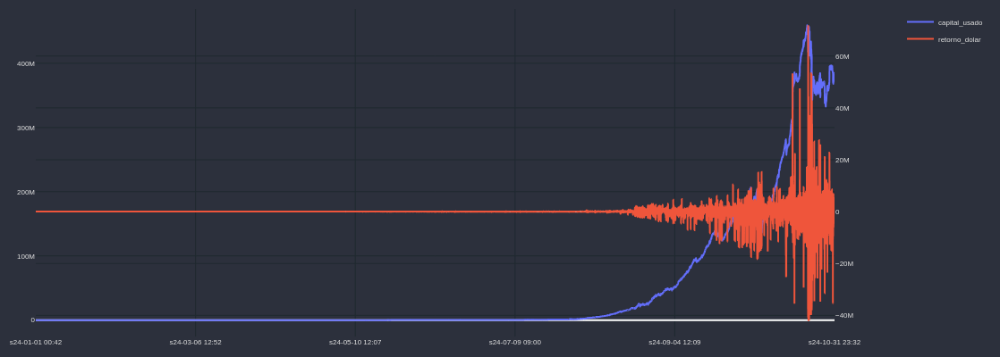

In [108]:
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_usado'], sec_traces=['retorno_dolar'])

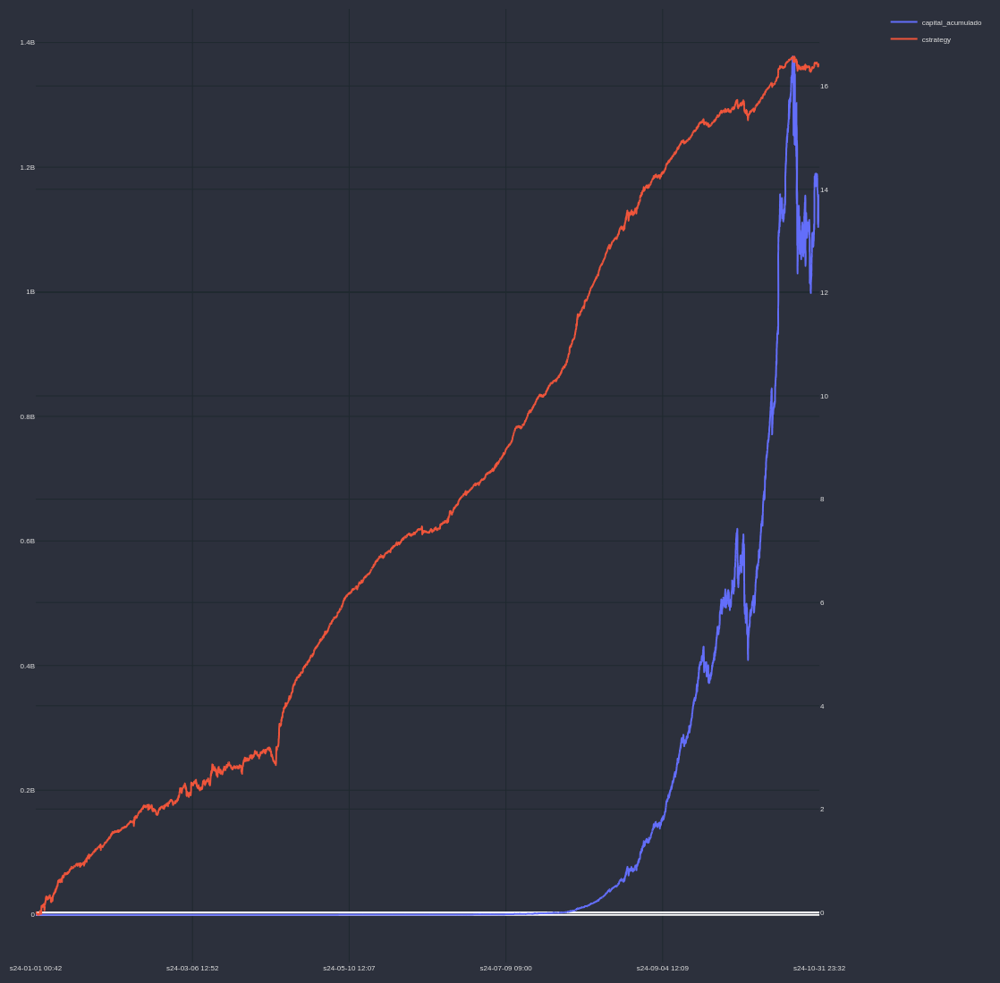

In [109]:
df_resultado_dinamico_alavancagem['cstrategy'] = df_resultado_dinamico_alavancagem.strategy_pair1.cumsum()
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_acumulado'], sec_traces=['cstrategy'], height=1100)